# Spotify Music Recommendation Algorithm

## Requisicão de dados do Spotify

In [4]:
import spotipy
from spotipy.oauth2 import SpotifyOAuth
import pandas as pd

client_id = '53d1d792b9b84b69a98251e9a3547cd7'
client_secret = '3387991e53ee4d5f9f59a4494b73f0a2'
redirect_uri = 'http://127.0.0.1:5000/auth/callback' 

sp = spotipy.Spotify(auth_manager=SpotifyOAuth(client_id=client_id,
                                               client_secret=client_secret,
                                               redirect_uri=redirect_uri,
                                               scope=["user-top-read", "user-read-recently-played"]))
tracks_info = []
limit = 50  

try:
    results = sp.current_user_recently_played(limit=limit)

    if results['items']:
        for item in results['items']:
            track_data = sp.track(item['track']['id'])
            audio_features = sp.audio_features(item['track']['id'])[0]

            if track_data and audio_features:
                track_info = {
                    'valence': audio_features.get('valence'),
                    'year': track_data['album']['release_date'][:4] if track_data['album'].get('release_date') else None,
                    'acousticness': audio_features.get('acousticness'),
                    'artists': ", ".join([artist['name'] for artist in track_data['artists']]) if track_data.get('artists') else None,
                    'danceability': audio_features.get('danceability'),
                    'duration_ms': track_data.get('duration_ms'),
                    'energy': audio_features.get('energy'),
                    'explicit': track_data.get('explicit'),
                    'id': track_data.get('id'),
                    'instrumentalness': audio_features.get('instrumentalness'),
                    'key': audio_features.get('key'),
                    'liveness': audio_features.get('liveness'),
                    'loudness': audio_features.get('loudness'),
                    'mode': audio_features.get('mode'),
                    'name': track_data.get('name'),
                    'popularity': track_data.get('popularity'),
                    'release_date': track_data['album'].get('release_date'),
                    'speechiness': audio_features.get('speechiness'),
                    'tempo': audio_features.get('tempo')
                }
                tracks_info.append(track_info)

    user_recent_tracks = pd.DataFrame(tracks_info)

except spotipy.exceptions.SpotifyException as e:
    print(f"Erro na API do Spotify: {e}")
except Exception as e:
    print(f"Erro geral: {e}")


In [5]:
 display(user_recent_tracks) 

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.533,2013,0.000031,Avenged Sevenfold,0.433,205933,0.9940,True,4OyfdJiHM6sbfkFmRLrygg,0.056400,2,0.1960,-6.004,1,Doing Time,55,2013-08-23,0.0833,160.033
1,0.683,2013,0.000297,Avenged Sevenfold,0.580,305906,0.9160,False,5anCkDvJ17aznvK5TED5uo,0.025900,3,0.1260,-4.358,0,Hail to the King,76,2013-08-23,0.0387,118.004
2,0.211,2013,0.000332,Avenged Sevenfold,0.576,323800,0.9060,False,1fQaoh3imrMunWVZh5kf90,0.061400,2,0.0908,-7.677,1,Shepherd of Fire,68,2013-08-23,0.0571,127.935
3,0.348,2004,0.017700,Slipknot,0.291,278600,0.9740,False,6wqJeItl3Vc3az4ZicSQAB,0.000005,6,0.8860,-2.997,0,Before I Forget,77,2004,0.1710,134.724
4,0.827,1975,0.276000,Rainbow,0.594,277226,0.7700,False,52bzQkgk8TznulGvKOPQTK,0.017600,7,0.0575,-8.267,0,Man On The Silver Mountain,55,1975-01-01,0.0320,107.484
5,0.669,1983,0.031800,Iron Maiden,0.285,252733,0.9080,False,4OROzZUy6gOWN4UGQVaZMF,0.009090,4,0.3110,-4.601,0,The Trooper - 2015 Remaster,71,1983,0.0705,159.756
6,0.249,1984,0.005630,Metallica,0.518,309973,0.8580,False,3LpHzQU2CZzZJGdUWV79SI,0.003490,0,0.0598,-6.147,1,For Whom The Bell Tolls - Remastered,69,1984-07-26,0.0672,117.897
7,0.500,1978,0.469000,Van Halen,0.225,102080,0.6890,False,2tAeN2TKlQLOoSPXtARzBV,0.813000,8,0.3370,-9.120,1,Eruption - 2015 Remaster,60,1978-02-10,0.0555,93.798
8,0.508,1971,0.019700,Black Sabbath,0.367,371120,0.6140,False,09EQqFGUTJW6X4NksMPM0O,0.051900,6,0.1780,-11.960,1,Into the Void (2009 Remaster),51,1971-07-21,0.0386,77.072
9,0.244,2015,0.002480,Ghost,0.496,253173,0.7250,False,6NFKy0jg3S6x380iuF47jX,0.007480,7,0.0895,-5.433,1,He Is,51,2015-01-01,0.0284,100.089


In [6]:
tracks_info = []
limit = 50 

try:
    results = sp.current_user_top_tracks(limit=limit, time_range='medium_term')

    if results['items']:
        for item in results['items']:
            track_data = sp.track(item['id'])
            audio_features = sp.audio_features(item['id'])[0]
            artist_ids = [artist['id'] for artist in track_data['artists']]
            artist_info = sp.artists(artist_ids)
            
            # Obter os gêneros dos artistas
            genres = set()
            for artist in artist_info['artists']:
                genres.update(artist.get('genres', []))

            # Verificar se track_data e audio_features são válidos
            if track_data and audio_features:
                track_info = {
                    'valence': audio_features.get('valence'),
                    'year': track_data['album']['release_date'][:4] if track_data['album'].get('release_date') else None,
                    'acousticness': audio_features.get('acousticness'),
                    'artists': ", ".join([artist['name'] for artist in track_data['artists']]) if track_data.get('artists') else None,
                    'danceability': audio_features.get('danceability'),
                    'duration_ms': track_data.get('duration_ms'),
                    'energy': audio_features.get('energy'),
                    'explicit': track_data.get('explicit'),
                    'id': track_data.get('id'),
                    'instrumentalness': audio_features.get('instrumentalness'),
                    'key': audio_features.get('key'),
                    'liveness': audio_features.get('liveness'),
                    'loudness': audio_features.get('loudness'),
                    'mode': audio_features.get('mode'),
                    'name': track_data.get('name'),
                    'popularity': track_data.get('popularity'),
                    'release_date': track_data['album'].get('release_date'),
                    'speechiness': audio_features.get('speechiness'),
                    'tempo': audio_features.get('tempo'),
                    'genres': ", ".join(genres)  # Gêneros dos artistas
                }
                tracks_info.append(track_info)

    # Criar o DataFrame sem a coluna 'played_at'
    user_top_tracks = pd.DataFrame(tracks_info)

except spotipy.exceptions.SpotifyException as e:
    print(f"Erro na API do Spotify: {e}")
except Exception as e:
    print(f"Erro geral: {e}")


In [7]:
user_recent_tracks.shape

(50, 19)

## Metodos Auxiliares

In [9]:
def bar_plot(data, x, y, title, is_ascending=None):

    """
    Cria um gráfico de barras a partir dos dados fornecidos.

    Parâmetros:
    - data: DataFrame contendo os dados a serem plotados.
    - x: Nome da coluna para o eixo x (variável categórica).
    - y: Nome da coluna para o eixo y (variável numérica).
    - title: Título do gráfico.
    - is_ascending: Opcional; se True, ordena as barras em ordem ascendente de y; 
      se False, ordena em ordem descendente.

    Retornos:
    - Nenhum: Exibe um gráfico de barras.
    """
    
    if is_ascending is not None: 
        data = data.sort_values(by=y, ascending=is_ascending)
    
    plt.figure(figsize=(18, 6))
    plt.gca().set_facecolor('#f9f9f9')
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(y)
    
    custom_palette = sns.color_palette("Greens", n_colors=len(data))

    bar_plot = sns.barplot(data=data, x=x, y=y, hue=x, palette=custom_palette)

    for p in bar_plot.patches:
        bar_plot.annotate(f'{p.get_height():.2f}', 
                          (p.get_x() + p.get_width() / 2., p.get_height()), 
                          ha='center', va='bottom', 
                          fontsize=10, color='black', 
                          xytext=(0, 5), 
                          textcoords='offset points')

    plt.show()

In [10]:
def line_plot(data, x, y,ylabel, title):

    """
    Plota um gráfico de linhas para os dados fornecidos.

    Parameters:
    data (DataFrame): Um DataFrame do pandas que contém os dados a serem plotados.
    x (str): O nome da coluna no DataFrame que será usada no eixo x.
    y (list of str): Uma lista com os nomes das colunas no DataFrame que serão plotadas no eixo y.
    ylabel (str): O rótulo do eixo y.
    title (str): O título do gráfico.

    Returns:
    None: A função exibe o gráfico, mas não retorna nenhum valor.
    
    Example:
    line_plot(data, 'month', ['sales', 'profit'], 'Value', 'Sales and Profit Over Time')
    """

    plt.figure(figsize=(12, 6))
    for column in y:
        plt.plot(data[x], data[column], marker='', label=column)
    
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(ylabel)
    plt.xticks(data[x]) 
    plt.legend()
    plt.grid()
    plt.show()


In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_features_vs_popularity(data, decade_col, features, target='popularity'):
    """
    Cria subplots de scatterplots e linhas de regressão para as características especificadas em relação à popularidade.

    Parâmetros:
    - data: DataFrame contendo os dados a serem plotados.
    - decade_col: Nome da coluna que contém as décadas.
    - features: Lista de colunas que representam as características a serem plotadas.
    - target: Nome da coluna que contém os dados de popularidade (padrão é 'popularity').

    Retornos:
    - Nenhum: Exibe os gráficos de dispersão.
    """
    # Filtrar dados para garantir que a coluna de década não tenha valores nulos
    data = data[data[decade_col].astype(bool)]

    # Selecionar apenas colunas numéricas que não são booleanas (ou seja, que não são 0 ou 1)
    numeric_features = []
    for feature in features:
        if data[feature].dtype in ['int64', 'float64']:
            # Excluir colunas que contêm apenas 0 e 1
            if not ((data[feature].nunique() == 2) and (set(data[feature].unique()).issubset({0, 1}))):
                numeric_features.append(feature)

    # Calcular a média dos atributos por década, ignorando colunas booleanas
    mean_df = data.groupby(decade_col)[numeric_features + [target]].mean().reset_index()

    # Calcular o número de subplots
    num_features = len(numeric_features)
    num_cols = 3  # Definir um número fixo de colunas
    num_rows = np.ceil(num_features / num_cols).astype(int)  # Calcular o número de linhas

    # Tamanho da figura
    plt.figure(figsize=(5 * num_cols, 4 * num_rows))  # Ajustar o tamanho da figura dinamicamente

    # Criar subplots
    for i, feature in enumerate(numeric_features, 1):
        plt.subplot(num_rows, num_cols, i)
        
        # Scatterplot para cada feature em relação à popularidade
        sns.scatterplot(data=mean_df, x=feature, y=target, hue=decade_col, palette='viridis', alpha=0.7, s=100)
        
        # Adicionar uma linha de regressão linear sem pontos de dispersão
        sns.regplot(data=mean_df, x=feature, y=target, scatter=False, color='red')
        
        # Títulos e rótulos
        plt.title(f'Relação entre {feature} e {target.capitalize()} (Média por {decade_col.capitalize()})')
        plt.xlabel(feature)
        plt.ylabel(target.capitalize())
        plt.grid()

    # Ajustar o layout dos subplots
    plt.tight_layout()

    # Exibir os gráficos
    plt.show()



## Dicionario de Dados

In [13]:
from IPython.display import display, HTML
import pandas as pd

In [14]:
data_dictionary_path = "music_data/Spotify_Data_Dictionary.csv"
data_dictionary = pd.read_csv(data_dictionary_path, encoding='ISO-8859-1')
display(HTML(data_dictionary.to_html(escape=False, max_rows=1000)))

,variable,class,description
0,track_id,character,Song unique ID
1,track_name,character,Song Name
2,track_artist,character,Song Artist
3,track_popularity,double,Song Popularity (0-100) where higher is better
4,track_album_id,character,Album unique ID
5,track_album_name,character,Song album name
6,track_album_release_date,character,Date when album released
7,playlist_name,character,Name of playlist
8,playlist_id,character,Playlist ID
9,playlist_genre,character,Playlist genre


## Analise Exploratoria dos Dados

In [16]:
music_data_path = "music_data/music_data.csv"
genre_df_path = "music_data/data_by_genres.csv"
year_data_path = "music_data/data_by_year.csv"

music_df = pd.read_csv(music_data_path)
genre_df = pd.read_csv(genre_df_path)
year_df = pd.read_csv(year_data_path)


In [17]:

for col in music_df.columns:
    if col in user_recent_tracks.columns:
        user_recent_tracks[col] = user_recent_tracks[col].astype(music_df[col].dtype)

new_tracks = user_recent_tracks[~user_recent_tracks['id'].isin(music_df['id'])]

new_tracks = new_tracks.reindex(columns=music_df.columns, fill_value=np.nan)

music_df = pd.concat([music_df, new_tracks], ignore_index=True)


music_df.columns

Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo'],
      dtype='object')

### Músicas

In [19]:
music_df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [20]:
print("{} Linhas e {} Colunas".format(music_df.shape[0], music_df.shape[1]))

170689 Linhas e 19 Colunas


In [21]:
music_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170689 entries, 0 to 170688
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170689 non-null  float64
 1   year              170689 non-null  int64  
 2   acousticness      170689 non-null  float64
 3   artists           170689 non-null  object 
 4   danceability      170689 non-null  float64
 5   duration_ms       170689 non-null  int64  
 6   energy            170689 non-null  float64
 7   explicit          170689 non-null  int64  
 8   id                170689 non-null  object 
 9   instrumentalness  170689 non-null  float64
 10  key               170689 non-null  int64  
 11  liveness          170689 non-null  float64
 12  loudness          170689 non-null  float64
 13  mode              170689 non-null  int64  
 14  name              170689 non-null  object 
 15  popularity        170689 non-null  int64  
 16  release_date      17

In [22]:
music_df.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
dtype: int64

In [23]:
unic_values = []
for i in music_df.columns[0:18].tolist():
    print(i, ':', len(music_df[i].astype(str).value_counts()))
    unic_values.append(len(music_df[i].astype(str).value_counts()))

valence : 1735
year : 103
acousticness : 4694
artists : 34107
danceability : 1242
duration_ms : 51769
energy : 2333
explicit : 2
id : 170686
instrumentalness : 5405
key : 12
liveness : 1741
loudness : 25417
mode : 2
name : 133663
popularity : 100
release_date : 11251
speechiness : 1626


In [24]:
music_df.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170689.000000,170689.000000,170689.000000,170689.000000,1.706890e+05,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000,170689.000000
mean,0.528575,1976.790326,0.502057,0.537377,2.309520e+05,0.482428,0.084575,0.167009,5.199925,0.205845,-11.467306,0.706876,31.435283,0.098383,116.860722
std,0.263165,25.917241,0.376038,0.176135,1.261124e+05,0.267657,0.278249,0.313468,3.515113,0.174802,5.697937,0.455196,21.826680,0.162725,30.707882
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.101000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.614000,0.000000,11.000000,0.034900,93.417000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.579000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624050e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2023.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


### Gênero

In [26]:
genre_df.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [27]:
print("{} Linhas e {} Colunas".format(genre_df.shape[0], genre_df.shape[1]))

2973 Linhas e 14 Colunas


In [28]:
genre_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [29]:
genre_df.isnull().sum()

mode                0
genres              0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

In [30]:
unic_values = []
for i in genre_df.columns[0:18].tolist():
    print(i, ':', len(genre_df[i].astype(str).value_counts()))
    unic_values.append(len(genre_df[i].astype(str).value_counts()))

mode : 2
genres : 2973
acousticness : 2798
danceability : 2725
duration_ms : 2872
energy : 2778
instrumentalness : 2731
liveness : 2709
loudness : 2873
speechiness : 2707
tempo : 2872
valence : 2745
popularity : 2188
key : 12


In [31]:
genre_df.describe()

,mode,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,2973.000000,2973.000000,2973.000000,2.973000e+03,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000
mean,0.833165,0.401241,0.537187,2.517209e+05,0.561143,0.211366,0.192800,-10.509848,0.083588,119.018723,0.492748,39.919185,5.938782
std,0.372891,0.319760,0.150668,9.465686e+04,0.234486,0.267329,0.092356,5.369202,0.080483,17.469188,0.201820,16.748723,3.368110
min,0.000000,0.000003,0.056900,3.094600e+04,0.001002,0.000000,0.022200,-41.825000,0.023800,47.135722,0.003353,0.000000,0.000000
25%,1.000000,0.119050,0.441202,2.063788e+05,0.395058,0.004835,0.137687,-12.427656,0.044900,109.198143,0.348578,32.491279,3.000000
50%,1.000000,0.321745,0.546496,2.375453e+05,0.601195,0.080700,0.178764,-9.221817,0.059457,119.194167,0.500048,43.056569,7.000000
75%,1.000000,0.673991,0.647500,2.772720e+05,0.730127,0.343333,0.220856,-6.920125,0.091000,127.508750,0.640257,51.138889,9.000000
max,1.000000,0.996000,0.929000,2.382587e+06,0.994667,0.992000,0.960000,0.060000,0.946219,204.212000,0.980000,80.666667,11.000000


### Ano

In [33]:
year_df.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [34]:
print("{} Linhas e {} Colunas".format(year_df.shape[0], year_df.shape[1]))

100 Linhas e 14 Colunas


In [35]:
year_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [36]:
year_df.isnull().sum()

mode                0
year                0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

In [37]:
unic_values = []
for i in year_df.columns[0:18].tolist():
    print(i, ':', len(year_df[i].astype(str).value_counts()))
    unic_values.append(len(year_df[i].astype(str).value_counts()))

mode : 1
year : 100
acousticness : 100
danceability : 100
duration_ms : 100
energy : 100
instrumentalness : 100
liveness : 100
loudness : 100
speechiness : 100
tempo : 100
valence : 100
popularity : 100
key : 7


In [38]:
year_df.describe()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0000
mean,1.0,1970.500000,0.556317,0.536783,227296.752234,0.452705,0.193582,0.208224,-11.969054,0.105861,116.015674,0.532120,27.376065,3.7900
std,0.0,29.011492,0.275358,0.052356,25630.048065,0.161738,0.122488,0.017903,3.105610,0.082128,5.669645,0.057809,20.703197,3.5627
min,1.0,1921.000000,0.219931,0.414445,156881.657475,0.207948,0.016376,0.168450,-19.275282,0.049098,100.884521,0.379327,0.140845,0.0000
25%,1.0,1945.750000,0.289516,0.500800,210889.193536,0.280733,0.103323,0.197509,-14.189232,0.064244,111.718626,0.497174,3.298200,0.0000
50%,1.0,1970.500000,0.459190,0.540976,235520.850833,0.495997,0.127644,0.206074,-11.773061,0.085763,117.455548,0.541503,33.619250,2.0000
75%,1.0,1995.250000,0.856711,0.570948,247702.738058,0.598008,0.276707,0.218493,-9.950542,0.104438,120.606644,0.570080,44.943375,7.0000
max,1.0,2020.000000,0.962607,0.692904,267677.823086,0.681778,0.581701,0.264335,-6.595067,0.490001,124.283129,0.663725,65.256542,10.0000


### Analise Visual

In [40]:
music_df['decade'] = (music_df['year'] // 10) * 10

mean_values = music_df.groupby('decade')[['acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo',
    'valence']].mean().reset_index()


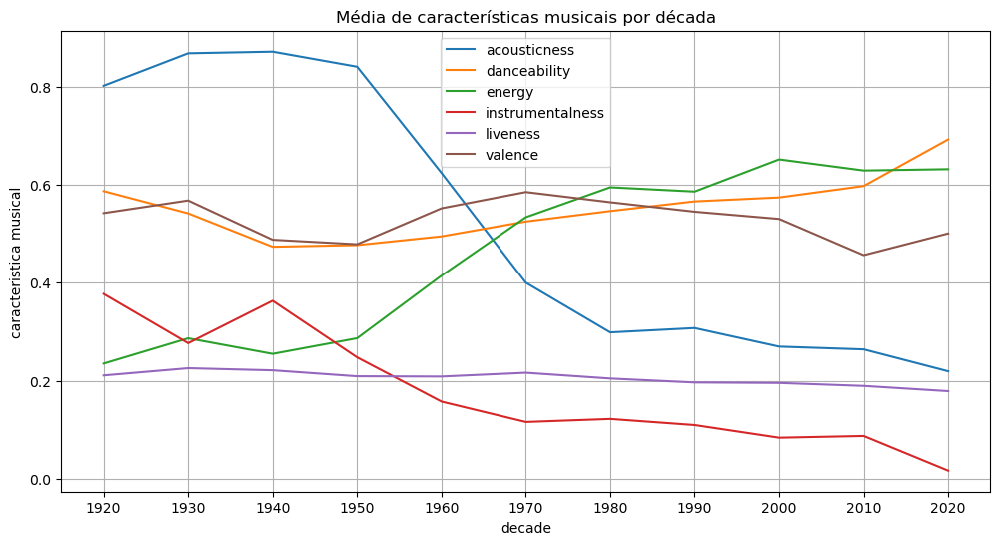

In [41]:
line_plot(data=mean_values,
          x='decade',
          y=['acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'valence'],
          ylabel='caracteristica musical', 
          title='Média de características musicais por década')

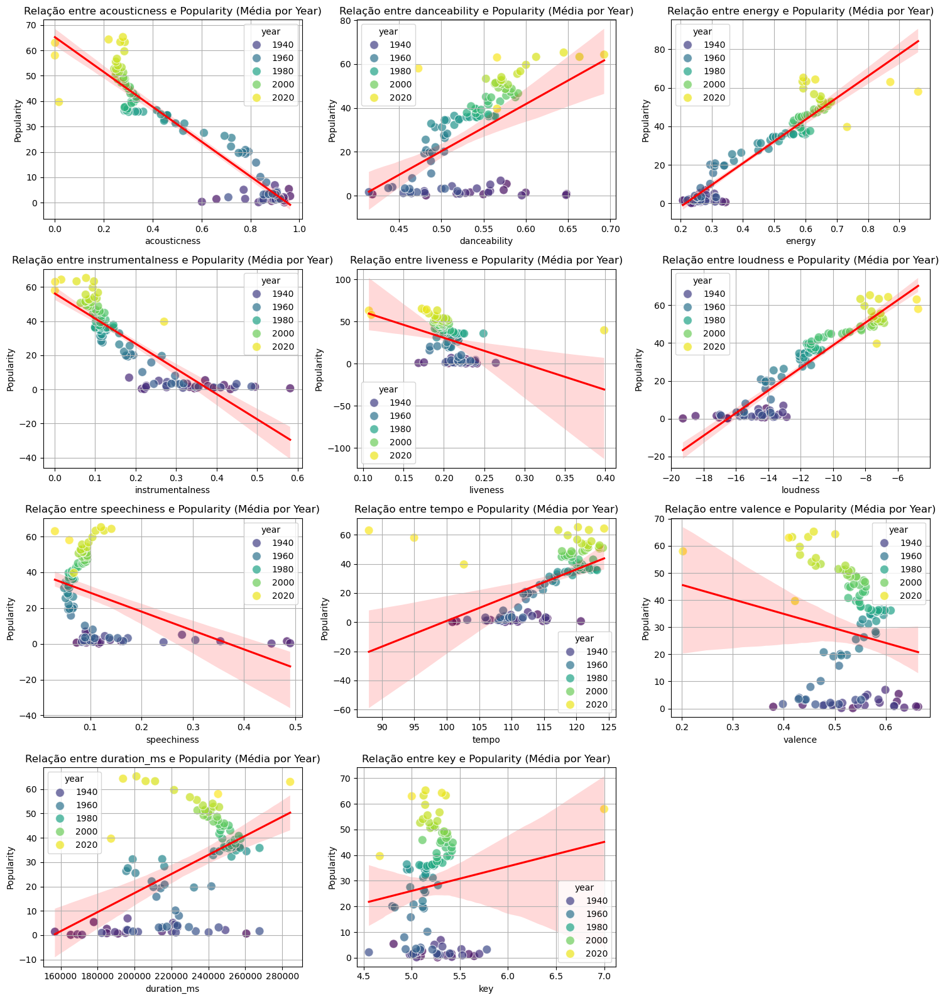

In [42]:
features = ['acousticness', 'danceability', 'energy', 'instrumentalness',
                 'liveness', 'loudness', 'speechiness', 'tempo', 
                 'valence', 'duration_ms', 'explicit', 'key', 'mode']
plot_features_vs_popularity(music_df, 'year', features, target='popularity')

## Treinamento

### Feature Correlation

#### Músicas

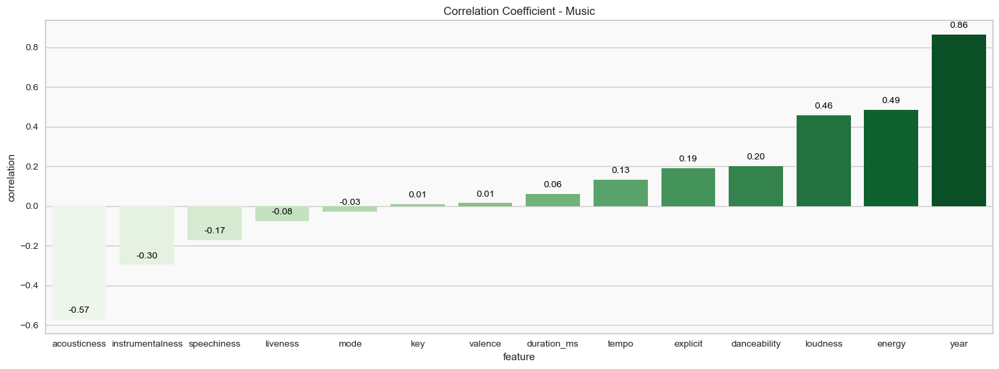

In [46]:
from yellowbrick.target import FeatureCorrelation

columns = [
    'valence',
    'year',
    'acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'explicit',
    'instrumentalness',
    'key',
    'liveness',
    'loudness',
    'mode',
    'speechiness',
    'tempo'
]

X = music_df[columns]
y = music_df['popularity']

# Cria o visualizador de correlação de características
visualizer = FeatureCorrelation(labels=columns)


correlation_data = X.corrwith(y)

correlation_df = pd.DataFrame({
    'feature': correlation_data.index,
    'correlation': correlation_data.values
})

bar_plot(correlation_df, 'feature', 'correlation', title='Correlation Coefficient - Music', is_ascending=True)


#### Genero

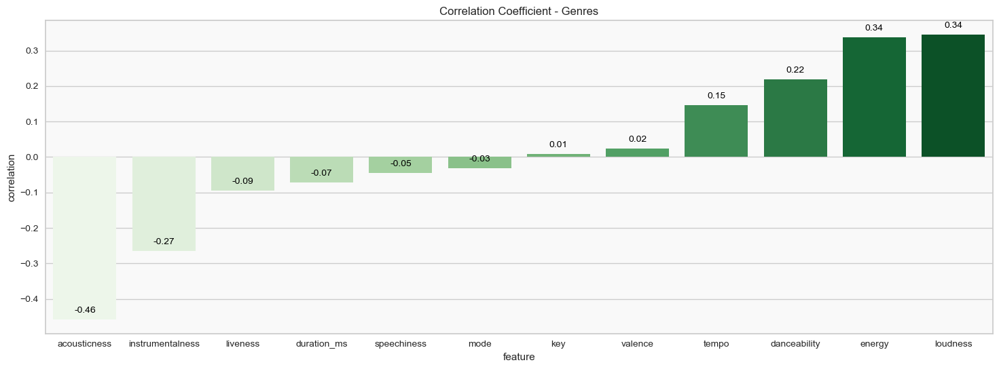

In [48]:
columns = ['mode',
    'acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo',
    'valence',
    'key'
]



X = genre_df[columns]
y = genre_df['popularity']

# Cria o visualizador de correlação de características
visualizer = FeatureCorrelation(labels=columns)


correlation_data = X.corrwith(y)

# Cria um DataFrame para os dados de correlação
correlation_df = pd.DataFrame({
    'feature': correlation_data.index,
    'correlation': correlation_data.values
})

# Chama a função bar_plot para visualizar a correlação
bar_plot(correlation_df, 'feature', 'correlation', title='Correlation Coefficient - Genres', is_ascending=True)




### Importancia das Variaveis

#### Musicas

In [51]:
from sklearn.ensemble import RandomForestClassifier 
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [52]:
x = music_df.drop(['artists', 'id', 'name','release_date', 'popularity'], axis=1)
y = music_df['popularity']

In [53]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [54]:
model = RandomForestClassifier()
model.fit(X_train, y_train)

RandomForestClassifier()

In [55]:
importances = model.feature_importances_
feature_names = x.columns

feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})


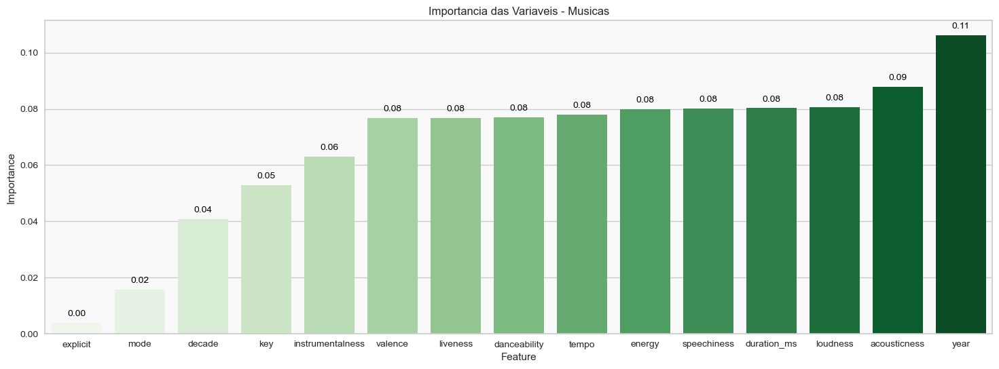

In [56]:
bar_plot(data=feature_importance_df,
         x='Feature',
         y='Importance',
         title='Importancia das Variaveis - Musicas',
         is_ascending=True)


#### Genero

In [58]:
x = genre_df.drop(['genres','popularity'], axis=1)

y = genre_df['popularity']

In [59]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [60]:
model = RandomForestRegressor() 
model.fit(X_train, y_train)

RandomForestRegressor()

In [61]:
importances = model.feature_importances_
feature_names = X.columns

feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})


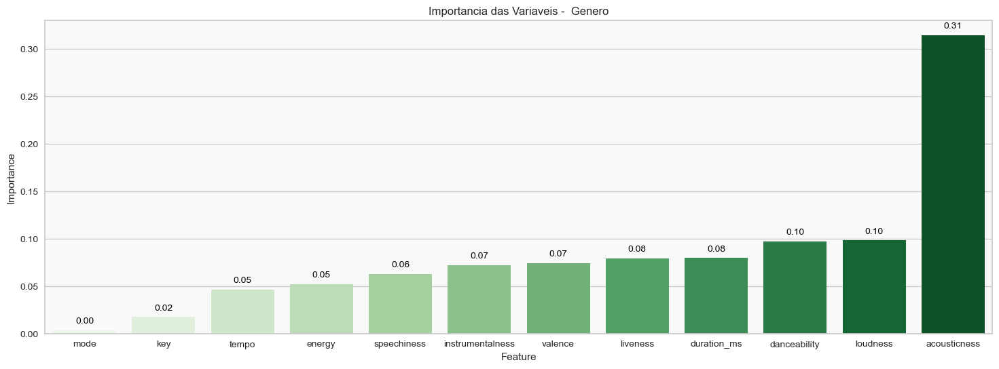

In [62]:
bar_plot(data=feature_importance_df,
         x='Feature',
         y='Importance',
         title='Importancia das Variaveis -  Genero',
         is_ascending=True)


#### Defiinição de Features

-  Usarei apenas as features com importancia maior ou igual a 0,06

In [65]:
music_features = ['valence',
    'year',
    'acousticness',
    'danceability',
    'duration_ms',
    'explicit',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo']

genres_features = ['acousticness', 
    'danceability',
    'duration_ms',
    'energy', 
    'instrumentalness',
    'liveness',
    'loudness', 
    'speechiness',
    'valence']

### Clusterização

#### Avalicação: Elbow Method

In [68]:
from sklearn.cluster import KMeans

In [69]:
x = music_df[music_features]
inertias = []
k_values = range(1, 20)


for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

elbow_music = pd.DataFrame({
    'Número de Clusters (k)': k_values,
    'Inércia': inertias
})

In [70]:
X = genre_df[genres_features]

inertias = []
k_values = range(1, 20)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

elbow_genre = pd.DataFrame({
    'Número de Clusters (k)': k_values,
    'Inércia': inertias
})


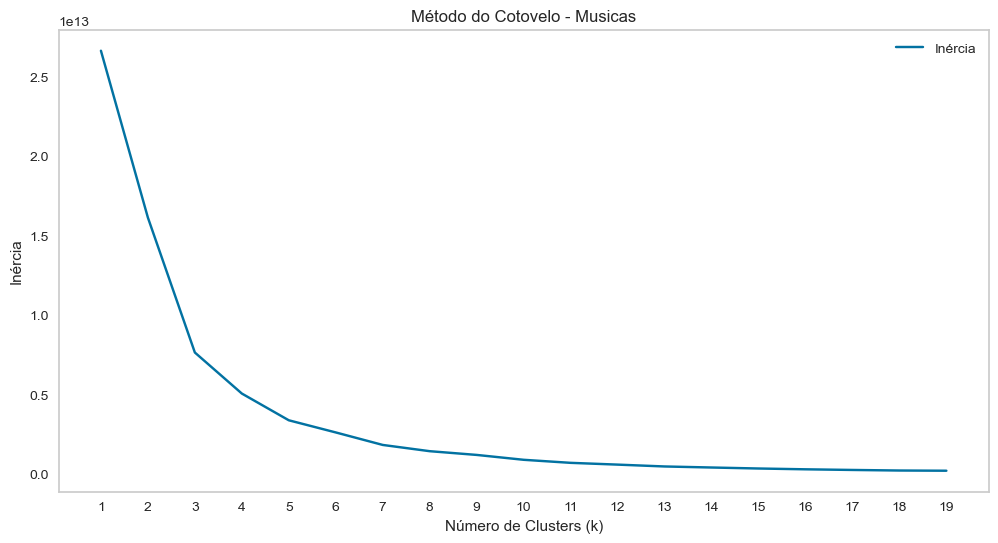

In [71]:
line_plot(elbow_music, 
          x='Número de Clusters (k)',
          y=['Inércia'], ylabel='Inércia',
          title='Método do Cotovelo - Musicas')


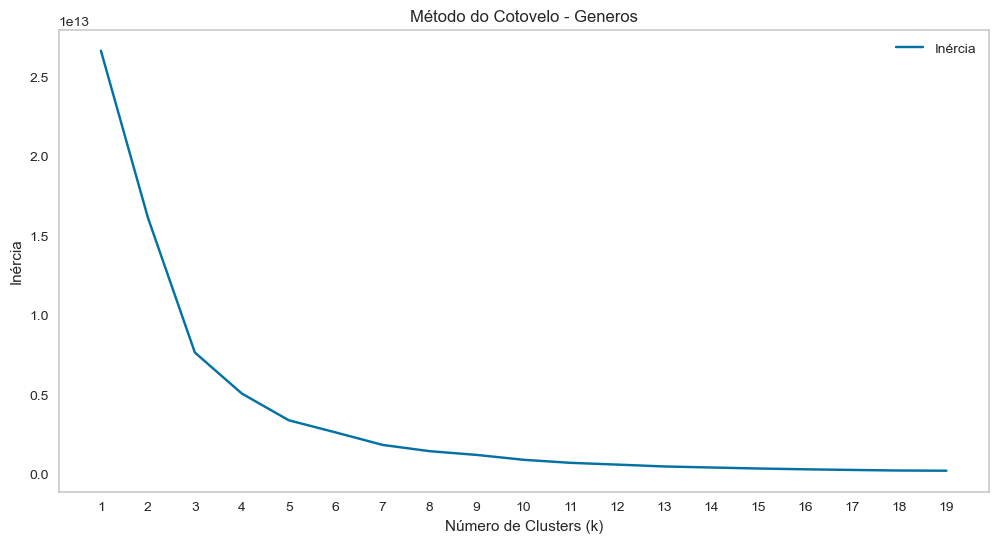

In [72]:
line_plot(elbow_genre,
          x='Número de Clusters (k)',
          y=['Inércia'],
          ylabel='Inércia',
          title='Método do Cotovelo - Generos')

- o ponto onde a inércia começa a diminuir em uma taxa mais lenta (o "cotovelo"). Esse ponto sugere o número ideal de clusters.

> Generos : 12
> 
> Musica: 12

#### Clusterização: KMeans

##### Musicas

In [76]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA


In [77]:
X = music_df[music_features]
number_cols = list(X.columns)

song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('kmeans', KMeans(n_clusters=7, n_init=30, verbose=0))
])

song_cluster_pipeline.fit(X)

song_cluster_labels = song_cluster_pipeline.predict(X)

music_df['cluster_label'] = song_cluster_labels


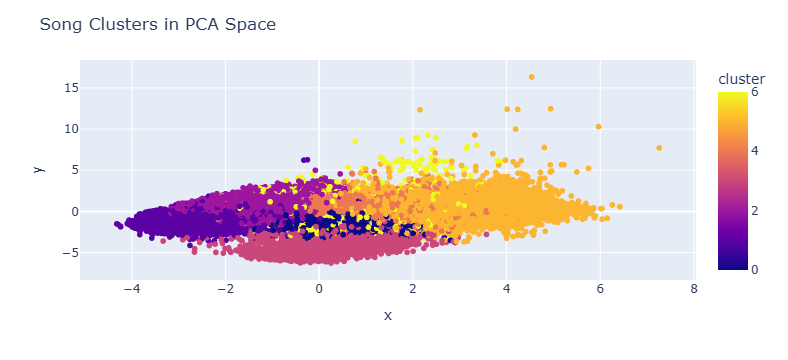

In [78]:

X = music_df[music_features]

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)


projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = music_df['name']
projection['cluster'] = music_df['cluster_label']


fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title']
)

fig.update_layout(title='Song Clusters in PCA Space')

# Show the plot
fig.show()


##### Genres

In [80]:
cluster_pipeline = Pipeline([('Scaler',
                              StandardScaler()),
                             ('KMeans',
                              KMeans(n_clusters=7,
                              n_init=30))])
X = genre_df[genres_features]

cluster_pipeline.fit(X)

genre_df['cluster'] = cluster_pipeline.predict(X)


In [81]:
tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_df['genres']
projection['cluster'] = genre_df['cluster']



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.012s...
[t-SNE] Computed neighbors for 2973 samples in 0.298s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.528424
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.491364
[t-SNE] KL divergence after 1000 iterations: 1.319808


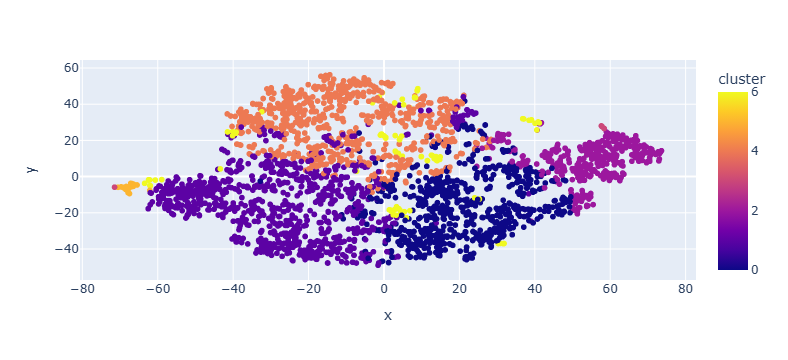

In [82]:
fig.update_layout(title='t-SNE Projection of Music Genres')
fig = px.scatter(
    projection,
    x='x',
    y='y',
    color='cluster',
    hover_data=['x', 'y', 'genres']
)

fig.show()

### Analise de Cluster

## Recomendacão

### Treinamento do Algoritmo de recomendação

#### Treinamento

In [87]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV

In [88]:
features = music_df[music_features]
labels = music_df['cluster_label'] 
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)

model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

predictions = model.predict(X_test)


In [89]:
print(classification_report(y_test, predictions))
print(confusion_matrix(y_test, predictions))

              precision    recall  f1-score   support

           0       0.95      0.95      0.95      9791
           1       1.00      1.00      1.00      3526
           2       0.97      0.98      0.98     18549
           3       1.00      0.98      0.99      1560
           4       0.95      0.95      0.95      8688
           5       0.98      0.97      0.97      6102
           6       0.97      0.94      0.96      2991

    accuracy                           0.97     51207
   macro avg       0.97      0.97      0.97     51207
weighted avg       0.97      0.97      0.97     51207

[[ 9339     0   201     1   162    63    25]
 [    0  3525     0     0     1     0     0]
 [  160     0 18209     1   140    15    24]
 [    9     2     3  1534     7     1     4]
 [  187     1   241     0  8213    28    18]
 [   85     0    51     0    49  5906    11]
 [   38     2    65     5    46    12  2823]]


### Matriz de Confusão###

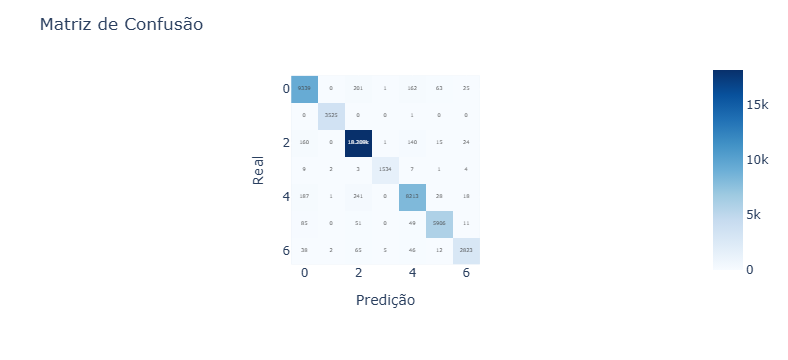

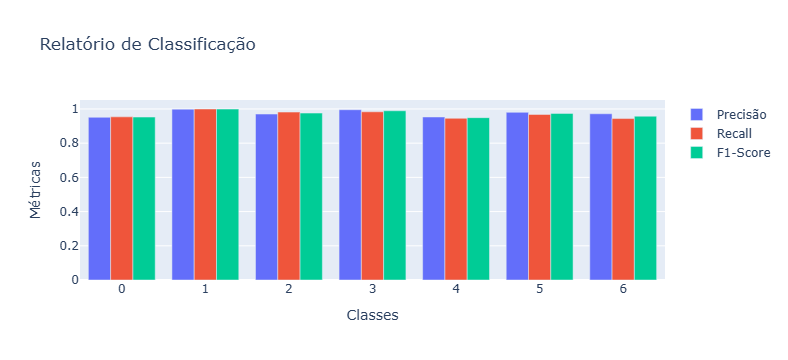

In [91]:
import plotly.graph_objects as go

cm = confusion_matrix(y_test, predictions)
cm_df = pd.DataFrame(cm, index=np.unique(y_test), columns=np.unique(y_test))

fig_cm = px.imshow(cm_df, text_auto=True, color_continuous_scale='Blues')
fig_cm.update_layout(title='Matriz de Confusão', xaxis_title='Predição', yaxis_title='Real')
fig_cm.show()

report = classification_report(y_test, predictions, output_dict=True)
report_df = pd.DataFrame(report).transpose()

fig_report = go.Figure()
fig_report.add_trace(go.Bar(x=report_df.index[:-3], y=report_df['precision'][:-3], name='Precisão'))
fig_report.add_trace(go.Bar(x=report_df.index[:-3], y=report_df['recall'][:-3], name='Recall'))
fig_report.add_trace(go.Bar(x=report_df.index[:-3], y=report_df['f1-score'][:-3], name='F1-Score'))

fig_report.update_layout(title='Relatório de Classificação',
                          xaxis_title='Classes',
                          yaxis_title='Métricas',
                          barmode='group')
fig_report.show()


### Curva Rpc

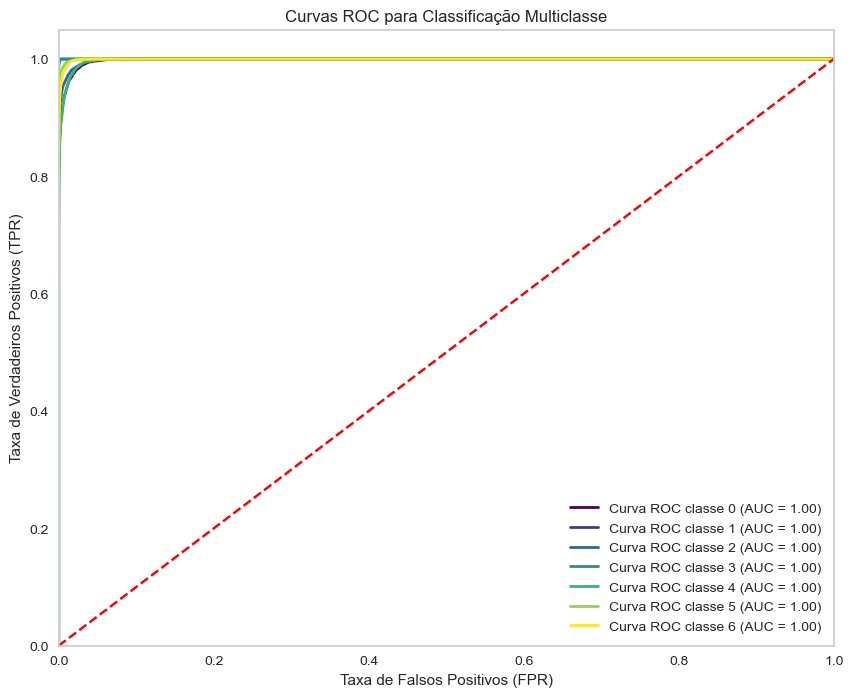

In [93]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Obter as probabilidades de previsão
y_probs = model.predict_proba(X_test)

n_classes = y_probs.shape[1]  # Número de classes

fpr = dict()
tpr = dict()
roc_auc = dict()

# Calcular FPR e TPR para cada classe
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotar as curvas ROC
plt.figure(figsize=(10, 8))
colors = plt.cm.viridis(np.linspace(0, 1, n_classes))

for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], color=colors[i], lw=2, 
             label='Curva ROC classe {0} (AUC = {1:0.2f})'.format(i, roc_auc[i]))

# Linha diagonal
plt.plot([0, 1], [0, 1], color='red', linestyle='--')

# Configurações do gráfico
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falsos Positivos (FPR)')
plt.ylabel('Taxa de Verdadeiros Positivos (TPR)')
plt.title('Curvas ROC para Classificação Multiclasse')
plt.legend(loc='lower right')
plt.grid()
plt.show()


# Treinando modelo

In [95]:
user_features = user_recent_tracks[music_features]  

user_predictions = model.predict(user_features)

user_recent_tracks['predicted_cluster'] = user_predictions


### Dividindo musicas nao ouvidas

In [97]:
# import joblib

# # Salvar o modelo
# joblib.dump(model, 'trained_model.pkl')


In [98]:
# model = joblib.load('trained_model.pkl')
# user_recent_tracks['predicted_cluster'] = user_predictions
# user_predictions = model.predict(user_features)

In [99]:
unheard_music = music_df.merge(user_recent_tracks[['id']], on='id', how='left', indicator=True).query('_merge == "left_only"').drop('_merge', axis=1)

print(f"Músicas não ouvidas disponíveis: {unheard_music.shape[0]}")
print(f"Músicas Totais: {music_df.shape[0]}")

heard_music_features = user_recent_tracks[music_features]
unheard_music_features = unheard_music[music_features]

print(f"Músicas ouvidas: {heard_music_features.shape[0]}")

Músicas não ouvidas disponíveis: 170639
Músicas Totais: 170689
Músicas ouvidas: 50


### Recomendação

In [101]:
# Configure pandas para mostrar mais casas decimais
pd.options.display.float_format = '{:.10f}'.format


In [102]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
import pandas as pd

def recommend_music(user_recent_tracks, unheard_music, n_recommendations=10):

    user_cluster = (user_recent_tracks['predicted_cluster'].value_counts().head(3).index).tolist()
    print((user_recent_tracks['predicted_cluster'].value_counts()))
    print(user_cluster)

    cluster_music = unheard_music[unheard_music['cluster_label'].isin(user_cluster)]

    heard_music_features = user_recent_tracks[music_features]
    cluster_music_features = cluster_music[music_features]

    similarity_scores = cosine_similarity(heard_music_features, cluster_music_features)

    recommendations = []

    for i in range(similarity_scores.shape[0]):
        # Obter índices das músicas mais similares
        similar_songs_idx = similarity_scores[i].argsort()[-n_recommendations:][::-1]
        similar_songs = cluster_music.iloc[similar_songs_idx]

        # Obter os valores de similaridade correspondentes
        similar_scores = similarity_scores[i][similar_songs_idx]

        # Adicionar os scores ao DataFrame
        similar_songs = similar_songs.copy()
        similar_songs['similarity'] = similar_scores

        recommendations.append(similar_songs)

    # Concatenar todas as recomendações em um único DataFrame
    recommended_songs = pd.concat(recommendations).drop_duplicates()
    return recommended_songs

# Exemplo de chamada da função
recommended_songs = recommend_music(user_recent_tracks, music_df)
display(recommended_songs.head(10))


predicted_cluster
2    31
1     5
6     5
4     4
0     3
5     2
Name: count, dtype: int64
[2, 1, 6]


,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,...,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label,similarity
107456,0.5330000000,2013,0.0000313000,['Avenged Sevenfold'],0.4330000000,205933,0.9940000000,1,4OyfdJiHM6sbfkFmRLrygg,0.0564000000,...,-6.0040000000,1,Doing Time,55,2013-08-23,0.0833000000,160.0330000000,2010,1,1.0000000000
107331,0.8970000000,2013,0.2390000000,['Keith Urban'],0.6190000000,205707,0.8820000000,0,1J8j3IeJz1HXoHF59LoP4h,0.0000000000,...,-5.9900000000,1,Little Bit Of Everything,51,2013-01-01,0.0912000000,159.9800000000,2010,2,0.9999999999
118922,0.1110000000,1990,0.0000159000,['Megadeth'],0.2120000000,203493,0.9950000000,0,5tOoS4trxEQ8GGTCAPZ2pe,0.6150000000,...,-6.5280000000,0,Take No Prisoners - Demo/Remastered 2004,37,1990-10-04,0.1250000000,160.2600000000,1990,2,0.9999999999
108320,0.2270000000,2018,0.0273000000,"['Playboi Carti', 'Bryson Tiller']",0.6570000000,206333,0.6680000000,1,1s9DTymg5UQrdorZf43JQm,0.0000000000,...,-6.2080000000,1,Fell In Luv (feat. Bryson Tiller),63,2018-05-11,0.1360000000,162.9970000000,2010,1,0.9999999999
124292,0.3470000000,2017,0.4790000000,"[""Olivia O'Brien""]",0.5020000000,206120,0.5800000000,1,7hCr1IIEbIZGG3fR7Gaptc,0.0000000000,...,-7.5070000000,0,Tequilawine,58,2017-11-17,0.4510000000,158.7350000000,2010,1,0.9999999999
120389,0.1540000000,1997,0.0000083500,['Foo Fighters'],0.2630000000,204027,0.9900000000,0,4ZnD7qmpP3NWA1ctUzeUIw,0.8000000000,...,-4.1790000000,0,The Colour And The Shape,42,1997-05-20,0.1420000000,158.2810000000,1990,2,0.9999999999
153852,0.8850000000,2011,0.3980000000,['Banda El Recodo'],0.5760000000,206080,0.5360000000,0,6TMqwd7izRsVz89MN8rKRg,0.0000000000,...,-5.0780000000,1,Sin Respiración,49,2011-01-01,0.0307000000,160.1940000000,2010,2,0.9999999998
135887,0.7340000000,1995,0.5620000000,['Banda Cuisillos'],0.5710000000,204127,0.7340000000,0,0WdmGXS6ZaKNUDzm81GU0Q,0.0000435000,...,-7.6730000000,1,La Faldita,39,1995-05-25,0.0425000000,155.3890000000,1990,2,0.9999999998
136033,0.8950000000,1996,0.0394000000,['The Mahones'],0.5340000000,204507,0.7910000000,0,6VEg22DAHZ3bVoLN0fgOFv,0.0044000000,...,-6.3170000000,1,Paint the Town Red,43,1996,0.0347000000,161.7870000000,1990,2,0.9999999998
146850,0.7670000000,1976,0.1310000000,['Patti Smith'],0.4540000000,201800,0.9620000000,0,49TDyRgRbpvpDOZJOslDlh,0.0001260000,...,-7.2010000000,1,Pumping,30,1976,0.0537000000,154.6470000000,1970,2,0.9999999998


# 

In [104]:
music_df[music_features].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170689 entries, 0 to 170688
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170689 non-null  float64
 1   year              170689 non-null  int64  
 2   acousticness      170689 non-null  float64
 3   danceability      170689 non-null  float64
 4   duration_ms       170689 non-null  int64  
 5   explicit          170689 non-null  int64  
 6   instrumentalness  170689 non-null  float64
 7   liveness          170689 non-null  float64
 8   loudness          170689 non-null  float64
 9   speechiness       170689 non-null  float64
 10  tempo             170689 non-null  float64
dtypes: float64(8), int64(3)
memory usage: 14.3 MB


<BarContainer object of 7 artists>

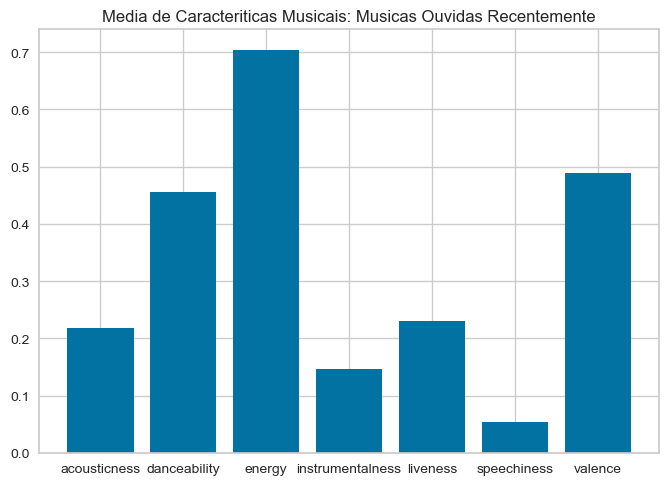

In [179]:
mean_values = user_recent_tracks[['acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'speechiness',
    'valence']].mean().reset_index()


mean_values.columns = ['Features', 'Mean_Values']

plt.title("Media de Caracteriticas Musicais: Musicas Ouvidas Recentemente")
plt.bar(mean_values['Features'],mean_values['Mean_Values'] )

<BarContainer object of 7 artists>

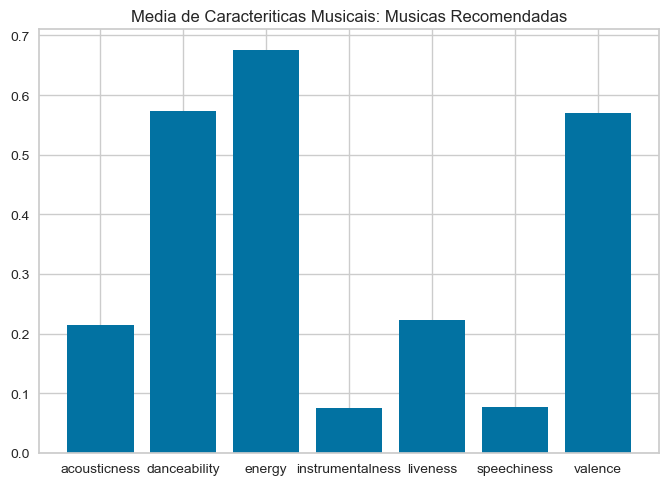

In [187]:

mean_values = recommended_songs[['acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'speechiness',
    'valence']].mean().reset_index()


mean_values.columns = ['Features', 'Mean_Values']
plt.title("Media de Caracteriticas Musicais: Musicas Recomendadas")
plt.bar(mean_values['Features'],mean_values['Mean_Values'] )